In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.style 
from sklearn.model_selection import train_test_split,GridSearchCV
from pandas_profiling import ProfileReport

In [ ]:
import warnings 
warnings.filterwarnings("ignore")

In [ ]:
data_train = pd.read_csv('/content/drive/MyDrive/Train.csv')

<H3>EDA Using Pandas Profiling<h3>

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

     | 25.9 MB 149 kB/s
     |████████████████████████████████| 10.1 MB 5.3 MB/s 
     |████████████████████████████████| 596 kB 39.8 MB/s 
     |████████████████████████████████| 102 kB 10.6 MB/s 
     |████████████████████████████████| 675 kB 41.6 MB/s 
     |████████████████████████████████| 4.7 MB 38.0 MB/s 
     |████████████████████████████████| 62 kB 695 kB/s 
     |████████████████████████████████| 812 kB 40.5 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.1.1-py2.py3-none-any.whl size=261287 sha256=f419d32fd537738364f371700dc561c5c58505969aac5122aca42b6711979fcd
  Stored in directory: /tmp/pip-ephem-wheel-cache-accc_hz9/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=40f5cb4ac79309de0c7b5cec4253e54aceea821b3c2b4dcf92c5aad1b09aeb90
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14

In [ ]:
profile = ProfileReport(data_train, title='Pandas Profiling Report', explorative=True)

In [ ]:
profile.to_widgets() 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

<H2>EDA</H2>

In [ ]:
data_train.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [ ]:
data_train.shape

(8523, 12)

In [ ]:
data_train.describe(include="all") 

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
count,8523,7060.000000,8523,8523.000000,8523,8523.000000,8523,8523.000000,6113,8523,8523,8523.000000
unique,1559,NaN,5,NaN,16,NaN,10,NaN,3,3,4,NaN
top,FDW13,NaN,Low Fat,NaN,Fruits and Vegetables,NaN,OUT027,NaN,Medium,Tier 3,Supermarket Type1,NaN
freq,10,NaN,5089,NaN,1232,NaN,935,NaN,2793,3350,5577,NaN
mean,NaN,12.857645,NaN,0.066132,NaN,140.992782,NaN,1997.831867,NaN,NaN,NaN,2181.288914
std,NaN,4.643456,NaN,0.051598,NaN,62.275067,NaN,8.371760,NaN,NaN,NaN,1706.499616
min,NaN,4.555000,NaN,0.000000,NaN,31.290000,NaN,1985.000000,NaN,NaN,NaN,33.290000
25%,NaN,8.773750,NaN,0.026989,NaN,93.826500,NaN,1987.000000,NaN,NaN,NaN,834.247400
50%,NaN,12.600000,NaN,0.053931,NaN,143.012800,NaN,1999.000000,NaN,NaN,NaN,1794.331000
75%,NaN,16.850000,NaN,0.094585,NaN,185.643700,NaN,2004.000000,NaN,NaN,NaN,3101.296400


In [ ]:
data_train.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

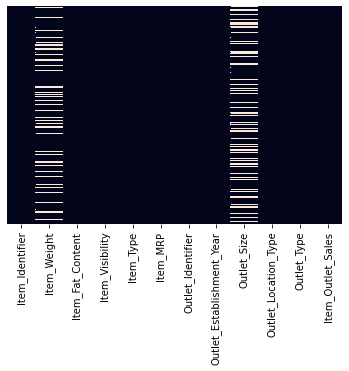

In [ ]:
sns.heatmap(data_train.isnull(),yticklabels=False,cbar=False)

In [ ]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            8523 non-null   object 
 1   Item_Weight                7060 non-null   float64
 2   Item_Fat_Content           8523 non-null   object 
 3   Item_Visibility            8523 non-null   float64
 4   Item_Type                  8523 non-null   object 
 5   Item_MRP                   8523 non-null   float64
 6   Outlet_Identifier          8523 non-null   object 
 7   Outlet_Establishment_Year  8523 non-null   int64  
 8   Outlet_Size                6113 non-null   object 
 9   Outlet_Location_Type       8523 non-null   object 
 10  Outlet_Type                8523 non-null   object 
 11  Item_Outlet_Sales          8523 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


Item_Weight is numerical column so we fill it with Mean Imputation

In [ ]:
data_train['Item_Weight'].fillna(data_train['Item_Weight'].median(),inplace=True)

Outlet_Size is catagorical column so we fill it with Mode Imputation

In [ ]:
data_train['Outlet_Size'].fillna(data_train['Outlet_Size'].mode()[0],inplace=True) 

In [ ]:
data_train.isnull().sum()

Item_Identifier              0
Item_Weight                  0
Item_Fat_Content             0
Item_Visibility              0
Item_Type                    0
Item_MRP                     0
Outlet_Identifier            0
Outlet_Establishment_Year    0
Outlet_Size                  0
Outlet_Location_Type         0
Outlet_Type                  0
Item_Outlet_Sales            0
dtype: int64

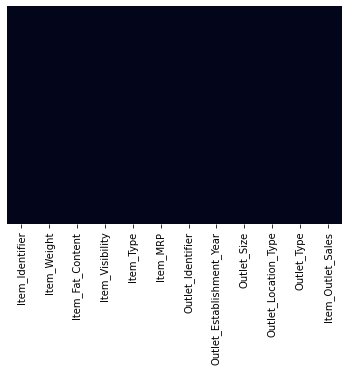

In [ ]:
sns.heatmap(data_train.isnull(),yticklabels=False,cbar=False)

<h4>Categorical Features:

1.Item_Identifier

2.Item_Fat_Content

3.Item_Type

4.Outlet_Identifier 

5.Outlet_Size

6.Outlet_Location_Type

7.Outlet_Type                
</h4>


In [ ]:
data_train.corr()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
Item_Weight,1.000000,-0.014168,0.024951,0.007739,0.009693
Item_Visibility,-0.014168,1.000000,-0.001315,-0.074834,-0.128625
Item_MRP,0.024951,-0.001315,1.000000,0.005020,0.567574
Outlet_Establishment_Year,0.007739,-0.074834,0.005020,1.000000,-0.049135
Item_Outlet_Sales,0.009693,-0.128625,0.567574,-0.049135,1.000000


<h2>Preprocessing the Data</h2>

In [ ]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()

In [ ]:
cat_list=['Item_Identifier','Item_Fat_Content','Item_Type','Outlet_Identifier','Outlet_Size','Outlet_Location_Type','Outlet_Type']

In [ ]:
for i in cat_list :
  data_train[i]= le.fit_transform(data_train[i])

In [ ]:
data_train.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,156,9.30,1,0.016047,4,249.8092,9,1999,1,0,1,3735.1380
1,8,5.92,2,0.019278,14,48.2692,3,2009,1,2,2,443.4228
2,662,17.50,1,0.016760,10,141.6180,9,1999,1,0,1,2097.2700
3,1121,19.20,2,0.000000,6,182.0950,0,1998,1,2,0,732.3800
4,1297,8.93,1,0.000000,9,53.8614,1,1987,0,2,1,994.7052


In [ ]:
data_train.shape

(8523, 12)

<h2>Checking for Duplicates</h2>

In [ ]:
dups = data_train.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))

Number of duplicate rows = 0


<h2>Checking for Outlier</h2>

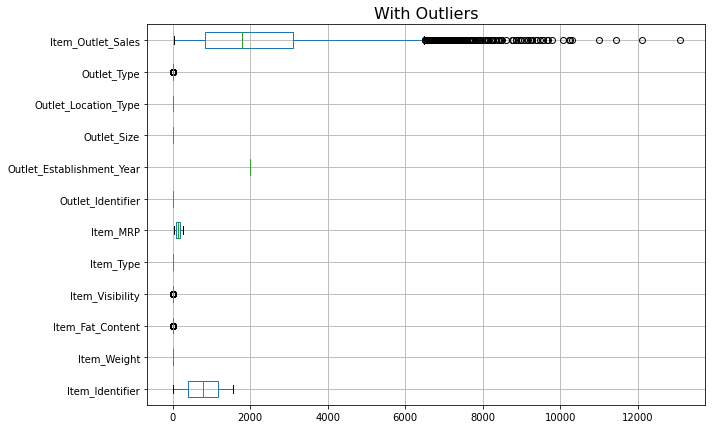

In [ ]:
cont=data_train.dtypes[(data_train.dtypes!='uint8')].index 
plt.figure(figsize=(10,7))
data_train[cont].boxplot(vert=0)
plt.title('With Outliers',fontsize=16)
plt.show() 

In [ ]:
def remove_outlier(col):
    sorted(col)
    Q1,Q3=np.percentile(col,[25,75])
    IQR=Q3-Q1
    lower_range= Q1-(1.5 * IQR)
    upper_range= Q3+(1.5 * IQR)
    return lower_range, upper_range

In [ ]:
for column in data_train[cont].columns:
    lr,ur=remove_outlier(data_train[column])
    data_train[column]=np.where(data_train[column]>ur,ur,data_train[column])
    data_train[column]=np.where(data_train[column]<lr,lr,data_train[column])

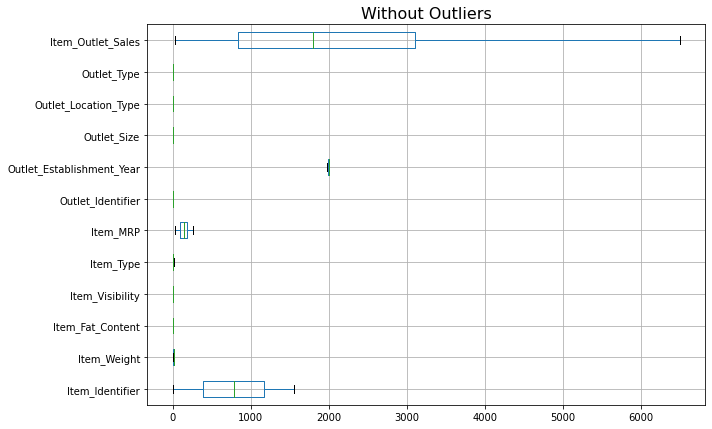

In [ ]:
plt.figure(figsize=(10,7))
data_train[cont].boxplot(vert=0)
plt.title('Without Outliers',fontsize=16)
plt.show() 

<h2>Handling Test Data</h2>

In [ ]:
data_test  =   pd.read_csv('/content/drive/MyDrive/Test.csv')

<h3>EDA Using Pandas Profiling<h3>

In [ ]:
profile = ProfileReport(data_test, title='Pandas Profiling Report', explorative=True)

In [ ]:
profile.to_widgets() 

Summarize dataset:   0%|          | 0/5 [00:01<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

<h2>EDA</h2>

In [ ]:
data_test.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,FDW58,20.750,Low Fat,0.007565,Snack Foods,107.8622,OUT049,1999,Medium,Tier 1,Supermarket Type1
1,FDW14,8.300,reg,0.038428,Dairy,87.3198,OUT017,2007,NaN,Tier 2,Supermarket Type1
2,NCN55,14.600,Low Fat,0.099575,Others,241.7538,OUT010,1998,NaN,Tier 3,Grocery Store
3,FDQ58,7.315,Low Fat,0.015388,Snack Foods,155.0340,OUT017,2007,NaN,Tier 2,Supermarket Type1
4,FDY38,NaN,Regular,0.118599,Dairy,234.2300,OUT027,1985,Medium,Tier 3,Supermarket Type3


In [ ]:
data_test.shape

(5681, 11)

In [ ]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5681 entries, 0 to 5680
Data columns (total 11 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            5681 non-null   object 
 1   Item_Weight                4705 non-null   float64
 2   Item_Fat_Content           5681 non-null   object 
 3   Item_Visibility            5681 non-null   float64
 4   Item_Type                  5681 non-null   object 
 5   Item_MRP                   5681 non-null   float64
 6   Outlet_Identifier          5681 non-null   object 
 7   Outlet_Establishment_Year  5681 non-null   int64  
 8   Outlet_Size                4075 non-null   object 
 9   Outlet_Location_Type       5681 non-null   object 
 10  Outlet_Type                5681 non-null   object 
dtypes: float64(3), int64(1), object(7)
memory usage: 488.3+ KB


In [ ]:
data_test.describe(include="all") 

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
count,5681,4705.000000,5681,5681.000000,5681,5681.000000,5681,5681.000000,4075,5681,5681
unique,1543,NaN,5,NaN,16,NaN,10,NaN,3,3,4
top,NCS41,NaN,Low Fat,NaN,Snack Foods,NaN,OUT027,NaN,Medium,Tier 3,Supermarket Type1
freq,8,NaN,3396,NaN,789,NaN,624,NaN,1862,2233,3717
mean,NaN,12.695633,NaN,0.065684,NaN,141.023273,NaN,1997.828903,NaN,NaN,NaN
std,NaN,4.664849,NaN,0.051252,NaN,61.809091,NaN,8.372256,NaN,NaN,NaN
min,NaN,4.555000,NaN,0.000000,NaN,31.990000,NaN,1985.000000,NaN,NaN,NaN
25%,NaN,8.645000,NaN,0.027047,NaN,94.412000,NaN,1987.000000,NaN,NaN,NaN
50%,NaN,12.500000,NaN,0.054154,NaN,141.415400,NaN,1999.000000,NaN,NaN,NaN
75%,NaN,16.700000,NaN,0.093463,NaN,186.026600,NaN,2004.000000,NaN,NaN,NaN


In [ ]:
data_test.isnull().sum()

Item_Identifier                 0
Item_Weight                   976
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  1606
Outlet_Location_Type            0
Outlet_Type                     0
dtype: int64

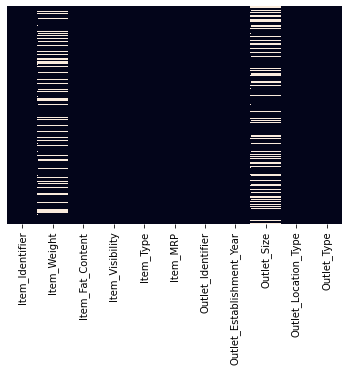

In [ ]:
sns.heatmap(data_test.isnull(),yticklabels=False,cbar=False)

In [ ]:
data_test['Item_Weight'].fillna(data_test['Item_Weight'].median(),inplace=True)
data_test['Outlet_Size'].fillna(data_test['Outlet_Size'].mode()[0],inplace=True) 

In [ ]:
data_test.isnull().sum()

Item_Identifier              0
Item_Weight                  0
Item_Fat_Content             0
Item_Visibility              0
Item_Type                    0
Item_MRP                     0
Outlet_Identifier            0
Outlet_Establishment_Year    0
Outlet_Size                  0
Outlet_Location_Type         0
Outlet_Type                  0
dtype: int64

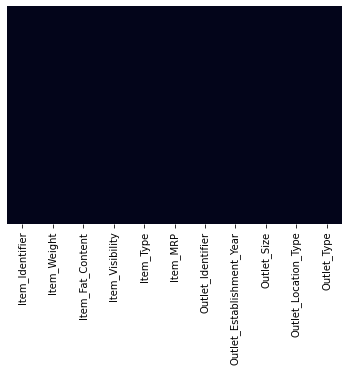

In [ ]:
sns.heatmap(data_test.isnull(),yticklabels=False,cbar=False)

In [ ]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5681 entries, 0 to 5680
Data columns (total 11 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            5681 non-null   object 
 1   Item_Weight                5681 non-null   float64
 2   Item_Fat_Content           5681 non-null   object 
 3   Item_Visibility            5681 non-null   float64
 4   Item_Type                  5681 non-null   object 
 5   Item_MRP                   5681 non-null   float64
 6   Outlet_Identifier          5681 non-null   object 
 7   Outlet_Establishment_Year  5681 non-null   int64  
 8   Outlet_Size                5681 non-null   object 
 9   Outlet_Location_Type       5681 non-null   object 
 10  Outlet_Type                5681 non-null   object 
dtypes: float64(3), int64(1), object(7)
memory usage: 488.3+ KB


In [ ]:
data_test.corr()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year
Item_Weight,1.000000,-0.018342,0.045048,0.025678
Item_Visibility,-0.018342,1.000000,-0.014013,-0.097040
Item_MRP,0.045048,-0.014013,1.000000,-0.007233
Outlet_Establishment_Year,0.025678,-0.097040,-0.007233,1.000000


<h2>Preprocessing the Data</h2>

In [ ]:
for i in cat_list :
  data_test[i]= le.fit_transform(data_test[i])

In [ ]:
data_test.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,1103,20.750,1,0.007565,13,107.8622,9,1999,1,0,1
1,1067,8.300,4,0.038428,4,87.3198,2,2007,1,1,1
2,1406,14.600,1,0.099575,11,241.7538,0,1998,1,2,0
3,809,7.315,1,0.015388,13,155.0340,2,2007,1,1,1
4,1184,12.500,2,0.118599,4,234.2300,5,1985,1,2,3


<h2>Checking for Duplicates</h2>

In [ ]:
dups = data_test.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))

Number of duplicate rows = 0


<h2>Checking for Outlier</h2>

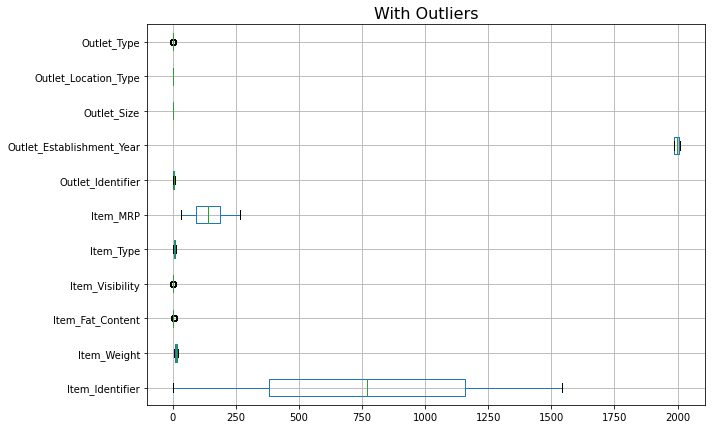

In [ ]:
cont=data_test.dtypes[(data_test.dtypes!='uint8')].index 
plt.figure(figsize=(10,7))
data_test[cont].boxplot(vert=0)
plt.title('With Outliers',fontsize=16)
plt.show() 

In [ ]:
def remove_outlier(col):
    sorted(col)
    Q1,Q3=np.percentile(col,[25,75])
    IQR=Q3-Q1
    lower_range= Q1-(1.5 * IQR)
    upper_range= Q3+(1.5 * IQR)
    return lower_range, upper_range

In [ ]:
for column in data_test[cont].columns:
    lr,ur=remove_outlier(data_test[column])
    data_test[column]=np.where(data_test[column]>ur,ur,data_test[column])
    data_test[column]=np.where(data_test[column]<lr,lr,data_test[column])

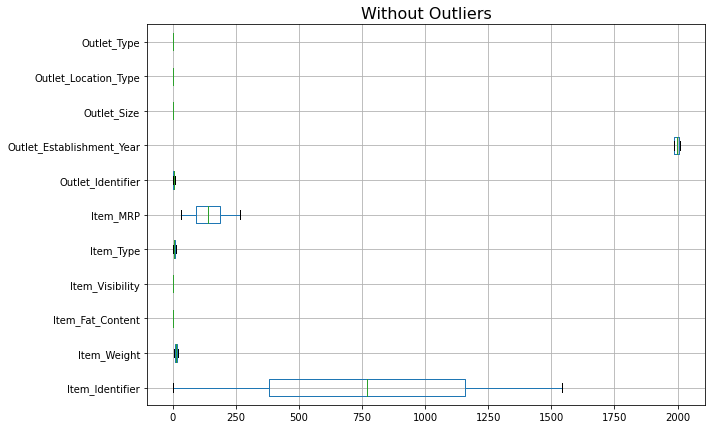

In [ ]:
plt.figure(figsize=(10,7))
data_test[cont].boxplot(vert=0)
plt.title('Without Outliers',fontsize=16)
plt.show() 

In [ ]:
X = data_train.drop(['Item_Outlet_Sales'], axis=1)
y = data_train['Item_Outlet_Sales'].values 

<h2>RandomForestRegressor</h2>

In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
param_grid = {
    'max_depth': [10,12,15],
    'max_features': [6,8],
    'min_samples_leaf': [2,4],
    'min_samples_split': [20,40],
    'n_estimators': [150,200,250]
}
rf = RandomForestRegressor(random_state=1)
clf_rf = GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3)
clf_rf.fit(X,y) 

GridSearchCV(cv=3, estimator=RandomForestRegressor(random_state=1),
             param_grid={'max_depth': [10, 12, 15], 'max_features': [6, 8],
                         'min_samples_leaf': [2, 4],
                         'min_samples_split': [20, 40],
                         'n_estimators': [150, 200, 250]})

In [ ]:
clf_rf.best_params_

{'max_depth': 10,
 'max_features': 6,
 'min_samples_leaf': 2,
 'min_samples_split': 40,
 'n_estimators': 250}

In [ ]:
best_rf= clf_rf.best_estimator_

In [ ]:
ypred_train = best_rf.predict(X)

In [ ]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [ ]:
print(r2_score(y,ypred))
print(mean_absolute_error(y,ypred))
print(np.sqrt(mean_squared_error(y,ypred))) 

0.6718329087449015
671.0084990474223
930.7623391084267


In [ ]:
ypred_test_rf = best_rf.predict(data_test)
print(ypred_test_rf) 

[1683.42929355 1320.6284604   624.83696476 ... 1856.28312613 3862.08032025
 1336.48124381]


<h2>DecisionTreeRegressor</h2>

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
param_grid = {
    'max_depth': [10,12,15],
    'max_features': [6,8],
    'min_samples_leaf': [2,4],
    'min_samples_split': [20,40]
}
dt = DecisionTreeRegressor(random_state=1)
clf_dt = GridSearchCV(estimator = dt, param_grid = param_grid, cv = 3)
clf_dt.fit(X, y) 

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(random_state=1),
             param_grid={'max_depth': [10, 12, 15], 'max_features': [6, 8],
                         'min_samples_leaf': [2, 4],
                         'min_samples_split': [20, 40]})

In [ ]:
clf_dt.best_params_

{'max_depth': 10,
 'max_features': 6,
 'min_samples_leaf': 4,
 'min_samples_split': 40}

In [ ]:
best_dt = clf_dt.best_estimator_

In [ ]:
ypred_dt = best_dt.predict(X)

In [ ]:
print(r2_score(y,ypred_dt))
print(mean_absolute_error(y,ypred_dt))
print(np.sqrt(mean_squared_error(y,ypred_dt))) 

0.6617045839258886
676.8938222107079
945.016399321546


In [ ]:
ypred_test_dt = best_dt.predict(data_test)
print(ypred_test_dt) 

[1604.02156772 1285.5347103   798.16104    ... 1800.90057344 4145.57041
 1328.48568653]


<h2>LinearRegression</h2>

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
lr= LinearRegression()

In [ ]:
lr.fit(X,y)

LinearRegression()

In [ ]:
ypred_lr=lr.predict(X) 

In [ ]:
print(r2_score(y,ypred_lr))
print(mean_absolute_error(y,ypred_lr))
print(np.sqrt(mean_squared_error(y,ypred_lr))) 

0.4558690132294909
929.257806109787
1198.5137415179377


In [ ]:
ypred_test_lr = lr.predict(data_test)
print(ypred_test_lr) 

[2153.10382089  684.50751983 2973.59346834 ... 2337.89976342 2616.71716511
 1736.7240288 ]


<h2>XGBoostRegressor</H2>

In [ ]:
from xgboost import XGBRegressor

In [ ]:
regressor = XGBRegressor()

In [ ]:
regressor.fit(X,y)

[08:55:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor()

In [ ]:
ypred_regressor=regressor.predict(X) 

In [ ]:
print(r2_score(y,ypred_regressor))
print(mean_absolute_error(y,ypred_regressor))
print(np.sqrt(mean_squared_error(y,ypred_regressor))) 

0.6325249767154948
717.4123805501225
984.9296275056404


In [ ]:
ypred_test_xg = regressor.predict(data_test)
print(ypred_test_xg) 

[1666.3328  1401.9324   700.95703 ... 1865.5996  3640.3254  1254.0771 ]


In [ ]:
print(ypred_test_rf) 

[1683.42929355 1320.6284604   624.83696476 ... 1856.28312613 3862.08032025
 1336.48124381]


In [ ]:
print(ypred_test_dt) 

[1604.02156772 1285.5347103   798.16104    ... 1800.90057344 4145.57041
 1328.48568653]


In [ ]:
print(ypred_test_lr) 

[2153.10382089  684.50751983 2973.59346834 ... 2337.89976342 2616.71716511
 1736.7240288 ]


In [ ]:
print(ypred_test_xg) 

[1666.3328  1401.9324   700.95703 ... 1865.5996  3640.3254  1254.0771 ]
